In [1]:
from TO_sim.Animation import *
from TO_sim.To_Draw import *
from TO_sim.Hysteresis_Kuramoto import *
from IPython.display import HTML
import matplotlib
import matplotlib.pyplot as plt
import numpy as np
matplotlib.rcParams['animation.embed_limit'] = 2**128

In [3]:
t_end = 200
m = 6
N = 500
dist = "Quantile Lorentzian"
dK = 0.2
dt = 0.1
Ksdf,Ksrdf = Hysteresis_pd(m,N=N,dK=dK,t_end=t_end,dist=dist,dt=dt,seed="Uniform")

  0%|          | 0/63 [00:00<?, ?it/s]

  0%|          | 0/63 [00:00<?, ?it/s]

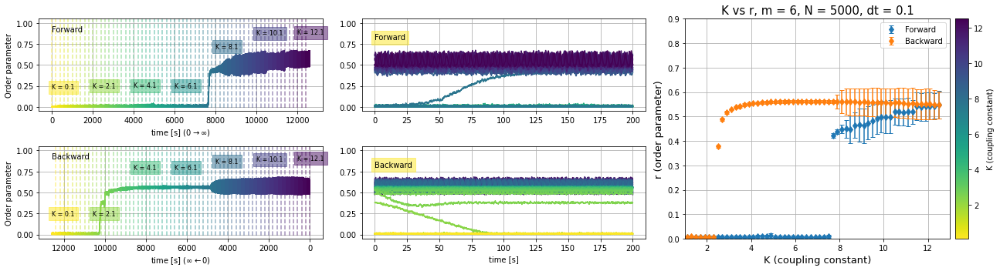

In [4]:
Time_R_df_total(Ksdf,Ksrdf,N,m,save=False,Folder_name="Review/Review5/",mean_time=50)

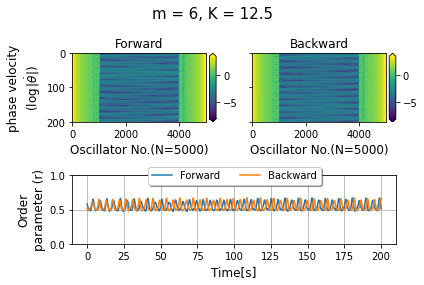

In [5]:
ani = Animation_logabs(Ksdf,Ksrdf,N,m)
HTML(ani.to_jshtml())

In [20]:
# Check_K,To_animate = Make_to_animate(Ksrdf,[[5.3,0,99.9],[5.5,0,99.9],[5.7,0,99.9],[5.9,0,99.9]],time_interval=10)
# Check_K,To_animate = Make_to_animate(Ksrdf,[[2.7,0,99.9],[2.5,0,99.9]],time_interval=10)
Check_K,To_animate = Make_to_animate(Ksrdf,[[7.7,0,160]],time_interval=2)
# Check_K,To_animate = Make_to_animate(Ksrdf,[[2.9,0,99.9],[3.1,0,99.9]],time_interval=10)

max_,min_
0.5731430351942035 -0.5732132472930784


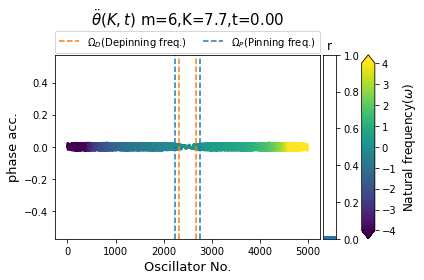

In [21]:
ani = ddtheta_animation(Ksdf,To_animate,Check_K,m)

In [15]:
HTML(ani.to_jshtml())

In [12]:
from TO_sim.Utility import *
Create_Folder('Review/Review5/Animation')
# createFolder('Review/Review5/Animation')

In [19]:
ani.save(f'Review/Review5/Animation/phase acc. m={m},N={N},K={Check_K}.mp4',dpi=400)

In [ ]:
def phase_cylindrical_animation(df,To_animate,Check_K,m):
    int_ =np.linspace(0,1,100)
    sin = lambda x : np.sin(x)
    cos = lambda x : np.cos(x)
    color = plt.cm.viridis(int_)
    sorted_color = lambda x: color[np.searchsorted(int_,x)]
    K_,t_s = To_animate[0]
    df = Ksdf
    ts_=df["ts"].iloc[0]
    rs_= df["rs"]
    color_ = rs_.apply(sorted_color)
    df = df.loc[Check_K]
    df_sin= df["theta_s"].apply(sin)
    df_cos= df["theta_s"].apply(cos)
    N = df_sin.iloc[0].shape[1]
    omega = df["Omega"][K_]
    

    fig = plt.figure(facecolor='white')
    ax = fig.add_subplot(111,aspect='equal')
    ax.set_xlim(-1.1,1.1)
    ax.set_ylim(-1.1,1.1)
    ax.tick_params(labelleft=False,left = False,labelbottom = False, bottom= False)

    ax.set_ylabel(r"$sin(\theta)$",fontsize=13)
    ax.set_xlabel(r"$cos(\theta)$",fontsize=13)
    t_s_time = ts_[t_s]
    ax.set_title(r'$\theta(K,t)$'+f'm={m},K={K_},t={t_s_time:.02f}',fontsize=15)
    sca = ax.scatter((df_cos[K_][t_s]),(df_sin[K_][t_s]),c=omega,vmin=-1,vmax=1,s=3)
    divider = make_axes_locatable(ax)
    rax = divider.append_axes('right', size='5%', pad=0.1)
    cax = divider.append_axes('right', size='5%', pad=0.35)
    cbar =fig.colorbar(sca, cax=cax,ax=cax, orientation='vertical',extend="both")
    cbar.set_label("Natural frequency($\omega$)",fontsize=12)

    rbar,=rax.bar(0,rs_[K_][t_s],color=color_[K_][t_s])
    rax.set_ylim(0,1)
    rax.set_title('r')
    rax.tick_params(labelleft=False,left = False,labelright = True, right= True,labelbottom = False, bottom= False)
    fig.tight_layout()
    def Update(To_animate):
        K_,t_s = To_animate
        t_s_time = ts_[t_s]
        sca.set_offsets(np.c_[(df_sin[K_][t_s]),(df_cos[K_][t_s])])
        rbar.set_height(rs_[K_][t_s])
        rbar.set_color(color_[K_][t_s])
        ax.set_title(r'$\theta(K,t)$'+f'm={m},K={K_},t={t_s_time:.02f}',fontsize=15)
    ani = FuncAnimation(fig, Update, frames=To_animate, interval=50)
    return ani

In [ ]:

K_ = 7.7
omega = Ksdf["Omega"].iloc[0]
KR = np.r_[Ksdf['rs'][K_]*K_,Ksdf['rs'][K_+0.2]*(K_+0.2)]
Kmr = (4/np.pi)*np.sqrt(KR/m)
sort = lambda a,b : np.arange(a,b+1)
A =list(map(sort,np.searchsorted(omega,-KR),np.searchsorted(omega,KR)))

In [21]:
df = Ksrdf
# df = df.loc[Check_K]
diff = lambda x : np.diff(x,axis=0)/dt
df["ddtheta_s"] = df["dtheta_s"].apply(diff)
df_=df["ddtheta_s"]
omega = df["Omega"].iloc[0]

In [23]:
KR = lambda df,K : df['rs'][K]*K
KMR = lambda x,m : (4/np.pi)*np.sqrt(x/m)
O_lset = lambda x:np.searchsorted(omega,-x)
O_rset = lambda x:np.searchsorted(omega,x)
Check_K = np.round(np.arange(0.1,12.5,0.2),1)
KR_ = KR(df,Check_K)
KMR_ = KR_.apply(KMR,m=m)
KR_lidx = KR_.apply(O_lset)
KR_ridx = KR_.apply(O_rset)

KMR_lidx = KMR_.apply(O_lset)
KMR_ridx = KMR_.apply(O_rset)


KR__ = np.concatenate([kr_ for kr_ in KR_])
KMR__ = np.concatenate([kr_ for kr_ in KMR_])

KR_u = np.searchsorted(omega,KR__)
KR_d = np.searchsorted(omega,-KR__)

KMR_u = np.searchsorted(omega,KMR__)
KMR_d = np.searchsorted(omega,-KMR__)


In [50]:
temp1 = []
temp2 = []
temp3 = []
temp4 = []
for i,_ in enumerate(Check_K):
    temp_1  = KMR_lidx[Check_K[i]][0]
    temp_2  = KMR_lidx[Check_K[i]][-1]
    temp_3  = KR_lidx[Check_K[i]][0]
    temp_4  = KR_lidx[Check_K[i]][-1]
    temp1.append(temp_1)
    temp2.append(temp_2)
    temp3.append(temp_3)
    temp4.append(temp_4)
# print(*temp1)
# print(*temp2)
To_array  =  lambda  x:  np.array(x)
temp1,temp2,temp3,temp4  =  map(To_array,(temp1,temp2,temp3,temp4))

array([ 3.3,  3.5,  3.7,  3.9,  4.1,  4.3,  4.5,  4.7,  4.9,  5.1,  5.3,
        5.5,  5.7,  5.9,  6.1,  6.3,  6.5,  6.7,  6.9,  7.1,  7.3,  7.5,
        7.7,  7.9,  8.1,  8.3,  8.5,  8.7,  8.9,  9.1,  9.3,  9.5,  9.7,
        9.9, 10.1, 10.3, 10.5, 10.7, 10.9, 11.1, 11.3, 11.5, 11.7, 11.9,
       12.1, 12.3])

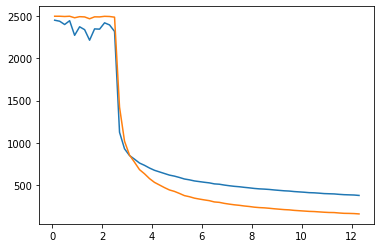

In [54]:
# plt.plot(Check_K,temp1)
plt.plot(Check_K,temp2)
# plt.plot(Check_K,temp3)
plt.plot(Check_K,temp4)
Check_K[temp1>temp3]
Check_K[temp2>temp4]

In [13]:
sort = lambda a,b,c,d : np.r_[np.arange(a,b+1),np.arange(c,d+1)]
reverse_N = lambda x : np.delete(np.arange(N),x)

In [83]:
reverse_N(np.array([1,2,3,4,5]),N)

array([   0,    6,    7, ..., 4997, 4998, 4999])

In [66]:
np.arange(N)[np.array([1,3,4,5])]

array([1, 3, 4, 5])

In [48]:
np.arange(10,1)

array([], dtype=int32)

In [14]:
A = list(map(sort,KR_d,KMR_d,KMR_u,KR_u))
B = list(map(sort,KMR_d,KR_d,KR_u,KMR_u))

Anot = list(reverse_N(x) for x in A)
# Anot = list(map(reverse_N,A))
Bnot = list(reverse_N(x) for x in B)
# Bnot = list(map(reverse_N,B))

In [ ]:
omega = Ksdf["Omega"].iloc[0]

plt.plot(np.searchsorted(omega,KR__),'tab:blue')
plt.plot(np.searchsorted(omega,-KR__),'tab:blue')
plt.plot(np.searchsorted(omega,KMR__),'tab:orange')
plt.plot(np.searchsorted(omega,-KMR__),'tab:orange')


In [ ]:
plt.plot(np.concatenate([kr_ for kr_ in KR_]))
plt.plot(np.concatenate([kr_ for kr_ in KMR_]))

In [29]:
KR_u[200]

311

(0.0, 500.0)

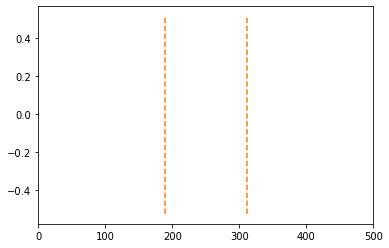

In [31]:
kr_l, =plt.plot([KR_u[0],KR_u[0]],[min_,max_],ls='--',color='tab:orange')
kr_r, =plt.plot([KR_d[0],KR_d[0]],[min_,max_],ls='--',color='tab:orange')
kr_r.set_xdata([KR_d[200],KR_d[200]])
kr_l.set_xdata([KR_u[200],KR_u[200]])
plt.xlim(0,500)
# kr_l.set_offsets([[10,min_],[100,min_]])

In [37]:
np.ravel([KR_u[0],KR_d[0]])

array([274, 226], dtype=int64)

In [41]:
x = np.ravel([KR_u[0],KR_d[0]])
masked_verts = np.ma.empty((len(x), 2, 2))
masked_verts[:, 0, 0] = x
masked_verts[:, 0, 1] = min_
masked_verts[:, 1, 0] = x
masked_verts[:, 1, 1] = max_
# 

In [43]:
masked_verts

masked_array(
  data=[[[274.        ,  -0.52351742],
         [274.        ,   0.51602705]],

        [[226.        ,  -0.52351742],
         [226.        ,   0.51602705]]],
  mask=False,
  fill_value=1e+20)

In [188]:

from cProfile import label


def make_colorbar(df_,fig,ax,omega):
    sca = ax.scatter(np.arange(1,N+1),(df_[t_s]),c=omega,vmin=-4,vmax=4,s=3)
    divider = make_axes_locatable(ax)
    cax = divider.append_axes('right', size='5%', pad=0.05)
    cbar =fig.colorbar(sca, cax=cax, orientation='vertical',extend="both")
    cbar.set_label("Natural frequency($\omega$)",fontsize=12)
    fig.tight_layout()

def ddtheta_animation(df,To_animate,Check_K,m):
    int_ =np.linspace(0,1,100)
    color = plt.cm.viridis(int_)
    sorted_color = lambda x: color[np.searchsorted(int_,x)]
    
    K_,t_s = To_animate[0]
    ts_=df["ts"].iloc[0]
    rs_= df["rs"]
    color_ = rs_.apply(sorted_color)
    dt = ts_[1]-ts_[0]
    df = df.loc[Check_K]
    diff = lambda x : np.diff(x,axis=0)/dt
    df["ddtheta_s"] = df["dtheta_s"].apply(diff)
    df_=df["ddtheta_s"]
    omega = df["Omega"][K_]
    max_ = df_.apply(np.max).max()  
    min_ = df_.apply(np.min).min()  

    print("max_,min_")
    print(max_,min_)
    N = df_.iloc[0].shape[1]
    
    fig = plt.figure(facecolor='white')
    ax = fig.subplots()
    ax.set_ylim(min_,max_)
    ax.set_xlabel("Oscillator No.",fontsize=13)
    ax.set_ylabel("phase acc.",fontsize=13)
    t_s_time = ts_[t_s]
    title = ax.set_title(r'$\ddot{\theta}(K,t)$'+f' m={m},K={K_},t={t_s_time:.02f}',fontsize=15,pad=30)
    sca = ax.scatter(np.arange(N),(df_[K_][t_s]),c=omega,vmin=-4,vmax=4,s=3)
    KR = lambda df,K : df['rs'][K]*K
    KMR = lambda x,m : (4/np.pi)*np.sqrt(x/m)
    KR_ = KR(df,Check_K)
    KMR_ = KR_.apply(KMR,m=m)
    KR_lidx = KR_.apply(O_lset)
    KR_ridx = KR_.apply(O_rset)
    KMR_lidx = KMR_.apply(O_lset)
    KMR_ridx = KMR_.apply(O_rset)

    kr_l, = ax.plot([KR_lidx[K_][t_s],KR_lidx[K_][t_s]],[min_,max_],ls='--',color='tab:orange',label = r'$\Omega_{D}$(Depinning freq.)')
    kr_r, = ax.plot([KR_ridx[K_][t_s],KR_ridx[K_][t_s]],[min_,max_],ls='--',color='tab:orange')

    kmr_l, = ax.plot([KMR_lidx[K_][t_s],KMR_lidx[K_][t_s]],[min_,max_],ls='--',color='tab:blue',label = r'$\Omega_{P}$(Pinning freq.)')
    kmr_r, = ax.plot([KMR_ridx[K_][t_s],KMR_ridx[K_][t_s]],[min_,max_],ls='--',color='tab:blue')

    divider = make_axes_locatable(ax)
    rax = divider.append_axes('right', size='5%', pad=0.05)
    cax = divider.append_axes('right', size='5%', pad=0.35)
    cbar =fig.colorbar(sca, cax=cax,ax=cax, orientation='vertical',extend="both")
    cbar.set_label("Natural frequency($\omega$)",fontsize=12)
    # ax.legend(bbox_to_anchor=(0.0, -.03), loc="lower left",bbox_transform=fig.transFigure, ncol=2)
    ax.legend(bbox_to_anchor=(0.0, 1.01, 1, 0.1), loc="lower left",mode="expand", borderaxespad=0, ncol=3)
    rbar,=rax.bar(0,rs_[K_][t_s])
    rax.set_ylim(0,1)
    rax.set_title('r')
    rax.tick_params(labelleft=False,left = False,labelright = True, right= True,labelbottom = False, bottom= False)
    fig.tight_layout()

    def Update(To_animate):
        K_,t_s = To_animate
        t_s_time = ts_[t_s]
        sca.set_offsets(np.c_[np.arange(N),(df_[K_][t_s])])
        rbar.set_height(rs_[K_][t_s])
        rbar.set_color(color_[K_][t_s])
        kr_l.set_xdata([KR_lidx[K_][t_s],KR_lidx[K_][t_s]])
        kr_r.set_xdata([KR_ridx[K_][t_s],KR_ridx[K_][t_s]])
        kmr_l.set_xdata([KMR_lidx[K_][t_s],KMR_lidx[K_][t_s]])
        kmr_r.set_xdata([KMR_ridx[K_][t_s],KMR_ridx[K_][t_s]])
        title.set_text(r'$\ddot{\theta}(K,t)$'+f' m={m},K={K_},t={t_s_time:.02f}')
    ani = FuncAnimation(fig, Update, frames=To_animate, interval=50)
    return ani

def dtheta_animation(df,To_animate,Check_K,m):
    int_ =np.linspace(0,1,100)
    color = plt.cm.viridis(int_)
    sorted_color = lambda x: color[np.searchsorted(int_,x)]
    
    K_,t_s = To_animate[0]
    ts_=df["ts"].iloc[0]
    rs_= df["rs"]
    color_ = rs_.apply(sorted_color)
    
    df = df.loc[Check_K]
    df_=df["dtheta_s"]
    omega = df["Omega"][K_]
    max_ = df_.apply(np.max).max()/100
    min_ = df_.apply(np.min).min()/100


    N = df_.iloc[0].shape[1]
    print("max_/100,min_/100")
    print(max_,min_)
    
    fig = plt.figure(facecolor='white')
    ax = fig.subplots()
    ax.set_ylim(min_,max_)
    ax.set_xlabel("Oscillator No.",fontsize=13)
    ax.set_ylabel("phase vel.",fontsize=13)
    t_s_time = ts_[t_s]
    # sca = ax.scatter(np.arange(1,N+1),(df_[t_s]),c=omega,vmin=-4,vmax=4,s=3)
    title = ax.set_title(r'$\dot{\theta}(K,t)$'+f' m={m},K={K_},t={t_s_time:.02f}',fontsize=15, pad= 30)
    sca = ax.scatter(np.arange(1,N+1),(df_[K_][t_s]),c=omega,vmin=-4,vmax=4,s=3)
    divider = make_axes_locatable(ax)
    KR = lambda df,K : df['rs'][K]*K
    KMR = lambda x,m : (4/np.pi)*np.sqrt(x/m)
    KR_ = KR(df,Check_K)
    KMR_ = KR_.apply(KMR,m=m)
    KR_lidx = KR_.apply(O_lset)
    KR_ridx = KR_.apply(O_rset)
    KMR_lidx = KMR_.apply(O_lset)
    KMR_ridx = KMR_.apply(O_rset)

    kr_l, =plt.plot([KR_lidx[K_][t_s],KR_lidx[K_][t_s]],[min_,max_],ls='--',color='tab:orange',label = r'$\Omega_{D}$(Depinning freq.)')
    kr_r, =plt.plot([KR_ridx[K_][t_s],KR_ridx[K_][t_s]],[min_,max_],ls='--',color='tab:orange')

    kmr_l, =plt.plot([KMR_lidx[K_][t_s],KMR_lidx[K_][t_s]],[min_,max_],ls='--',color='tab:blue',label = r'$\Omega_{P}$(Pinning freq.)')
    kmr_r, =plt.plot([KMR_ridx[K_][t_s],KMR_ridx[K_][t_s]],[min_,max_],ls='--',color='tab:blue')
    ax.legend(bbox_to_anchor=(0.0, 1.01, 1, 0.1), loc="lower left",mode="expand", borderaxespad=0, ncol=3)
    
    rax = divider.append_axes('right', size='5%', pad=0.1)
    cax = divider.append_axes('right', size='5%', pad=0.35)
    cbar =fig.colorbar(sca, cax=cax,ax=cax, orientation='vertical',extend="both")
    cbar.set_label("Natural frequency($\omega$)",fontsize=12)
    
    rbar,=rax.bar(0,rs_[K_][t_s],color=color_[K_][t_s])
    rax.set_ylim(0,1)
    rax.set_title('r')
    rax.tick_params(labelleft=False,left = False,labelright = True, right= True,labelbottom = False, bottom= False)
    fig.tight_layout()
    def Update(To_animate):
        K_,t_s = To_animate
        t_s_time = ts_[t_s]
        sca.set_offsets(np.c_[np.arange(1,N+1),(df_[K_][t_s])])
        rbar.set_height(rs_[K_][t_s])
        rbar.set_color(color_[K_][t_s])
        kr_l.set_xdata([KR_lidx[K_][t_s],KR_lidx[K_][t_s]])
        kr_r.set_xdata([KR_ridx[K_][t_s],KR_ridx[K_][t_s]])
        kmr_l.set_xdata([KMR_lidx[K_][t_s],KMR_lidx[K_][t_s]])
        kmr_r.set_xdata([KMR_ridx[K_][t_s],KMR_ridx[K_][t_s]])
        title.set_text(r'$\dot{\theta}(K,t)$'+f' m={m},K={K_},t={t_s_time:.02f}')
    ani = FuncAnimation(fig, Update, frames=To_animate, interval=50)
    return ani

def theta_animation(df,To_animate,Check_K,m):
    int_ =np.linspace(0,1,100)
    color = plt.cm.viridis(int_)
    sorted_color = lambda x: color[np.searchsorted(int_,x)]
    sin = lambda x: np.sin(x)
    K_,t_s = To_animate[0]
    
    ts_=df["ts"].iloc[0]
    rs_= df["rs"]
    color_ = rs_.apply(sorted_color)
    df = df.loc[Check_K]
    df_= df["theta_s"].apply(sin)
    N = df_.iloc[0].shape[1]
    omega = df["Omega"][K_]
    max_ = df_.apply(np.max).max()  
    min_ = df_.apply(np.min).min()  
    print("max,min")
    print(max_,min_)
    
    fig = plt.figure(facecolor='white')
    ax = fig.subplots()
    
    ax.set_ylim(min_,max_)
    ax.set_xlabel("Oscillator No.",fontsize=13)
    ax.set_ylabel(r"$sin(\theta)$",fontsize=13)
    t_s_time = ts_[t_s]
    title = ax.set_title(r'$\theta(K,t)$'+f' m={m},K={K_},t={t_s_time:.02f}',fontsize=15, pad = 30)
    sca = ax.scatter(np.arange(1,N+1),(df_[K_][t_s]),c=omega,vmin=-4,vmax=4,s=3)
    
    KR = lambda df,K : df['rs'][K]*K
    KMR = lambda x,m : (4/np.pi)*np.sqrt(x/m)
    KR_ = KR(df,Check_K)
    KMR_ = KR_.apply(KMR,m=m)
    KR_lidx = KR_.apply(O_lset)
    KR_ridx = KR_.apply(O_rset)
    KMR_lidx = KMR_.apply(O_lset)
    KMR_ridx = KMR_.apply(O_rset)

    kr_l, =plt.plot([KR_lidx[K_][t_s],KR_lidx[K_][t_s]],[min_,max_],ls='--',color='tab:orange',label = r'$\Omega_{D}$(Depinning freq.)')
    kr_r, =plt.plot([KR_ridx[K_][t_s],KR_ridx[K_][t_s]],[min_,max_],ls='--',color='tab:orange')

    kmr_l, =plt.plot([KMR_lidx[K_][t_s],KMR_lidx[K_][t_s]],[min_,max_],ls='--',color='tab:blue',label = r'$\Omega_{P}$(Pinning freq.)')
    kmr_r, =plt.plot([KMR_ridx[K_][t_s],KMR_ridx[K_][t_s]],[min_,max_],ls='--',color='tab:blue')
    ax.legend(bbox_to_anchor=(0.0, 1.01, 1, 0.1), loc="lower left",mode="expand", borderaxespad=0, ncol=3)

    divider = make_axes_locatable(ax)
    rax = divider.append_axes('right', size='5%', pad=0.1)
    cax = divider.append_axes('right', size='5%', pad=0.35)
    cbar =fig.colorbar(sca, cax=cax,ax=cax, orientation='vertical',extend="both")
    cbar.set_label("Natural frequency($\omega$)",fontsize=12)
    
    rbar,=rax.bar(0,rs_[K_][t_s],color=color_[K_][t_s])
    rax.set_ylim(0,1)
    rax.set_title('r')
    rax.tick_params(labelleft=False,left = False,labelright = True, right= True,labelbottom = False, bottom= False)
    fig.tight_layout()
    def Update(To_animate):
        K_,t_s = To_animate
        t_s_time = ts_[t_s]
        sca.set_offsets(np.c_[np.arange(1,N+1),(df_[K_][t_s])])
        rbar.set_height(rs_[K_][t_s])
        rbar.set_color(color_[K_][t_s])
        kr_l.set_xdata([KR_lidx[K_][t_s],KR_lidx[K_][t_s]])
        kr_r.set_xdata([KR_ridx[K_][t_s],KR_ridx[K_][t_s]])
        kmr_l.set_xdata([KMR_lidx[K_][t_s],KMR_lidx[K_][t_s]])
        kmr_r.set_xdata([KMR_ridx[K_][t_s],KMR_ridx[K_][t_s]])
        title.set_text(r'$\theta(K,t)$'+f' m={m},K={K_},t={t_s_time:.02f}')
    ani = FuncAnimation(fig, Update, frames=To_animate, interval=50)
    return ani

In [173]:
To_animate[:10]

[(3.9, 0),
 (3.9, 10),
 (3.9, 20),
 (3.9, 30),
 (3.9, 40),
 (3.9, 50),
 (3.9, 60),
 (3.9, 70),
 (3.9, 80),
 (3.9, 90)]

max,min
0.9999999999999951 -0.9999999999999504


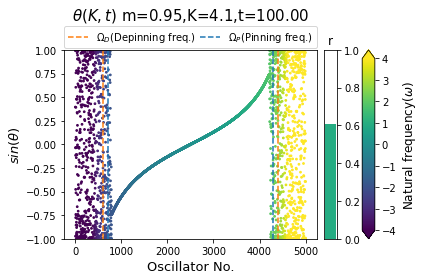

In [189]:
ani = theta_animation(Ksdf,To_animate[300:320],Check_K,m)

In [190]:
HTML(ani.to_jshtml())